<a href="https://colab.research.google.com/github/VivianPita/lab_iagi/blob/main/tesi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Import libraries and hyperparameters

In [1]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
# Plotting
%matplotlib inline
%reload_ext tensorboard
import seaborn as sns
import matplotlib.pyplot as plt

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as TF
import torch.optim as optim
import albumentations as A

from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler, ConcatDataset, TensorDataset, random_split
from torchvision import datasets, transforms
from torch.utils.tensorboard import SummaryWriter
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm

# Utilites
import zipfile
import glob
import os
import requests
import shutil
import numpy as np
import pandas as pd
import sklearn
import random
from PIL import Image

from shutil import copyfile
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score

In [3]:
# urls where you can find the dataset
dataset_url = 'https://zenodo.org/records/7358126/files/bdappv.zip?download=1'
data_url = 'https://zenodo.org/records/7358126/files/data.zip?download=1'
urls = [data_url, dataset_url]
# Change this to save and extract files in different directory
first_directory = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation'
dataset_directory = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/dataset'
img_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/bdappv/ign/img'
mask_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/bdappv/ign/mask'
to_delete = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/bdappv/google'
train_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/train'
val_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/validation'
test_dir =  '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/test'
train_img_dir =  '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/train/img'
train_mask_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/train/mask'
val_img_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/validation/img'
val_mask_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/validation/mask'
test_img_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/test/img'
test_mask_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/test/mask'
checkpoint_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints'
model_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models'
lr_dir = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/learning_rate'

In [4]:
SEED = 42
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
batch_size = 32
num_epochs = 30
num_workers = 2
h = 200
w = 200 # Original: 400 x 400
pin_memory = True
load_model = False
best_lr = 0.001

In [5]:
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

set_seed(SEED)

#Dataset Manipulation

##filtraggio immagini con meno di 10kb

In [ ]:
# Percorso della directory del dataset
dataset_directory = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/dataset'

# Elenco dei file nella directory del dataset
file_list = os.listdir(dataset_directory)

# Percorre tutti i file nella directory
for file_name in file_list:
    file_path = os.path.join(dataset_directory, file_name)
    # Controlla se il file è un file immagine e se il suo peso è inferiore a 10 KB
    if os.path.isfile(file_path) and os.path.getsize(file_path) < 10 * 1024:  # 10 KB in byte
        # Elimina il file
        os.remove(file_path)
        print(f"File eliminato: {file_path}")

##utils splitting

In [ ]:
def split_and_move(files_paths):
    for directory, file_list in files_paths:
        # Create main directory
        os.makedirs(directory, exist_ok=True)

        # Create subdirectories img., mask and no_mask (to add them later)
        img_directory = os.path.join(directory, 'img/')
        mask_directory = os.path.join(directory, 'mask/')
        no_masks_directory = os.path.join(directory, 'no_mask/')
        os.makedirs(img_directory, exist_ok=True)
        os.makedirs(mask_directory, exist_ok=True)
        os.makedirs(no_masks_directory, exist_ok=True)

        # Create file path
        file_path = os.path.join(directory, f'{os.path.basename(directory)}.txt')
        file_no_mask_path = os.path.join(directory, f'{os.path.basename(directory)}_no_masks.txt')

        # Check if file already exists
        if os.path.exists(file_path):
            print(f"Path to file already exists: {file_path}")
        else:
            print(f"Writing to file: {file_path}")
            content = []
            content_no_mask = []
            for file_name in file_list:
                image_path = os.path.join(IMG_DIR, file_name)
                mask_path = os.path.join(MASK_DIR, file_name)
                if os.path.exists(image_path) and os.path.exists(mask_path):
                    content.append(file_name)
                else:
                    if os.path.exists(image_path) and not os.path.exists(mask_path):
                        content_no_mask.append(file_name)
                    else:
                        raise ValueError("Impossible")

            # Write content to file
            with open(file_path, 'w') as file:
                file.write('\n'.join(content))

            with open(file_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    # Clean the line by removing leading and trailing whitespace and newline characters
                    cleaned_line = line.strip()

                    # Get the file paths for the image and mask
                    img_file_path = os.path.join(IMG_DIR, cleaned_line)
                    mask_file_path = os.path.join(MASK_DIR, cleaned_line)

                    # Check if the image and mask files exist and copy them in the new dir
                    if os.path.exists(img_file_path) and os.path.exists(mask_file_path):
                        shutil.move(img_file_path, os.path.join(img_directory, cleaned_line))
                        shutil.move(mask_file_path, os.path.join(mask_directory, cleaned_line))

                    # Write content to file
            with open(file_no_mask_path, 'w') as file:
                file.write('\n'.join(content_no_mask))

            with open(file_no_mask_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    # Clean the line by removing leading and trailing whitespace and newline characters
                    cleaned_line = line.strip()

                    # Get the file paths for the image and mask
                    img_file_path = os.path.join(IMG_DIR, cleaned_line)

                    # Check if the image doesn't have a mask and copy them in the new dir
                    if os.path.exists(img_file_path) and not os.path.exists(mask_file_path):
                        shutil.move(img_file_path, os.path.join(no_masks_directory, cleaned_line))

            print(f"Content for {file_path} written: {len(content)} lines")

##splitting

In [ ]:
img_files = [file for file in os.listdir(img_dir) if file.endswith(('jpg', 'jpeg', 'png', 'bmp'))]
# Shuffle the list of image files
random.shuffle(img_files)
set_seed(SEED)
# Calculate the sizes of train, validation, and test sets
num_images = len(img_files)
train_size = int(0.6 * num_images)  # 60% for train
val_size = int(0.2 * num_images)    # 20% for validation
test_size = num_images - train_size - val_size  # Remaining for testing
train_files = img_files[:train_size]
val_files = img_files[train_size:train_size + val_size]
test_files = img_files[train_size + val_size:]

##trainset

In [ ]:
train_path = train_dir
files_paths = [(train_path, train_files)]
split_and_move(files_paths)

##valset

In [ ]:
val_path = val_dir
files_paths = [(val_path, val_files)]
split_and_move(files_paths)

##testset

In [ ]:
test_path = test_dir
files_paths = [(test_path, test_files)]
split_and_move(files_paths)

#Model UNet

In [6]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)

class UNET(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, features=[64, 128, 256, 512]):
        super(UNET, self).__init__()
        self.ups = nn.ModuleList()
        self.downs = nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Down part of UNET
        for feature in features:
            self.downs.append(DoubleConv(in_channels, feature))
            in_channels = feature

        # Up part of UNET
        for feature in reversed(features):
            self.ups.append(
                nn.ConvTranspose2d(feature*2, feature, kernel_size=2, stride=2)
            )
            self.ups.append(DoubleConv(feature*2, feature))

        self.bottleneck = DoubleConv(features[-1], features[-1]*2)
        self.final_conv = nn.Conv2d(features[0], out_channels, kernel_size=1)

    def forward(self, x):
        skip_connections = []

        for down in self.downs:
            x = down(x)
            skip_connections.append(x)
            x = self.pool(x)

        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1]

        for idx in range(0, len(self.ups), 2):
            x = self.ups[idx](x)
            skip_connection = skip_connections[idx//2]

            if x.shape != skip_connection.shape:
                x = F.interpolate(x, size=skip_connection.shape[2:], mode='bilinear', align_corners=True)

            concat_skip = torch.cat((skip_connection, x), dim=1)
            x = self.ups[idx+1](concat_skip)

        x = self.final_conv(x)
        return x

In [7]:
model = UNET(in_channels=3, out_channels=1).to(DEVICE)
dummy_input = torch.randn(1, 3, 256, 256).squeeze(1).to(DEVICE)
output = model(dummy_input)

print("Test on dummy input")
print("Output: ", output.shape)
print("Input: ", dummy_input.shape)

Test on dummy input
Output:  torch.Size([1, 1, 256, 256])
Input:  torch.Size([1, 3, 256, 256])


#Dataset Class

In [8]:
class IGNDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.images = os.listdir(image_dir)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        img_path = os.path.join(self.image_dir, self.images[index])
        mask_path = os.path.join(self.mask_dir, self.images[index])

        image = np.array(Image.open(img_path).convert("RGB"))
        mask = np.array(Image.open(mask_path).convert("L"), dtype=np.float32)

        mask[mask == 255.0] = 1.0

        if self.transform is not None:
            augmentations = self.transform(image=image, mask=mask)
            image = augmentations["image"]
            mask = augmentations["mask"]

        return image, mask

#Colab Storage

In [9]:
train_img = '/content/train/img'
train_mask = '/content/train/mask'
val_img = '/content/validation/img'
val_mask = '/content/validation/mask'
test_img = '/content/test/img'
test_mask = '/content/test/mask'

def copy_if_not_exist(source_dir, dest_dir):
    if not os.path.exists(dest_dir):
        shutil.copytree(source_dir, dest_dir)

# Copy directories if they don't exist
copy_if_not_exist(train_img_dir, train_img)
copy_if_not_exist(train_mask_dir, train_mask)
copy_if_not_exist(val_img_dir, val_img)
copy_if_not_exist(val_mask_dir, val_mask)
copy_if_not_exist(test_img_dir, test_img)
copy_if_not_exist(test_mask_dir, test_mask)

#Metrics + Utils for train and checkpoint

In [10]:
def save_model(model, optimizer, train_loss, other_loss, type_other_loss, lr,
                    f1_score, accuracy, iou, miou,
                    epoch, dir, name):
    checkpoint = {
        'train_loss': train_loss,
        'other_loss': other_loss,
        'type_other_loss': type_other_loss,
        'lr': lr,
        'f1-score': f1_score,
        'accuracy': accuracy,
        'iou': iou,
        'miou': miou,
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }
    path = os.path.join(dir, f'{name}.pt')
    '''
    if os.path.exists(path):
        os.remove(path)  # Remove the old checkpoint if it exists
    '''
    torch.save(checkpoint, path)
    print(f'Saved checkpoint: {path}')

In [11]:
def train(model, train_loader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    data_iterator = tqdm(train_loader, desc='Train', position=0, leave=True)

    for batch_idx, (images, masks) in enumerate(data_iterator):
        images = images.to(device)
        masks = masks.float().unsqueeze(1).to(device)
        optimizer.zero_grad()
        outputs = model(images).to(device)

        loss = criterion(outputs, masks)

        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        # Update the progress bar description without causing wait
        data_iterator.set_postfix({'loss': running_loss / (batch_idx + 1)})

    epoch_loss = running_loss / len(train_loader)

    return epoch_loss

In [12]:
def val(model, val_loader, criterion, device):
    model.eval()  # Set the model to evaluation mode
    y_true = []
    y_pred = []
    val_loss = 0.0

    # Load all batches with tqdm
    data_iterator = tqdm(val_loader, desc='Validation', position=0, leave=True)

    with torch.no_grad():
        # Iterate over the loaded batches
        for batch_idx, (images, masks) in enumerate(data_iterator):
            masks = masks.float().unsqueeze(1).to(device)
            images = images.to(device)

            # Forward pass
            outputs = model(images)

            # Compute loss
            loss = criterion(outputs, masks)
            val_loss += loss.item()

            # Convert predictions to binary
            preds = torch.sigmoid(outputs)
            preds[preds >= 0.5] = 1
            preds[preds < 0.5] = 0

            masks_np = masks.cpu().numpy().squeeze().flatten()
            preds_np = preds.cpu().numpy().squeeze().flatten()
            y_true.extend(masks_np)
            y_pred.extend(preds_np)

            # Update the progress bar description without causing wait
            data_iterator.set_postfix({'loss': val_loss / (batch_idx + 1)})

    val_loss = val_loss / len(val_loader)

    return val_loss, y_true, y_pred

In [13]:
def metrics(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()

    # F1 score
    precision = tp / (tp + fp)
    recall = tp / (tp + fn)
    f1_score = 2 * (precision * recall) / (precision + recall)

    # IoU and mIoU
    iou = tp / (tp + fp + fn)
    miou = (tp / (tp + fp + fn) + tn / (tn + fn + tp)) / 2

    # Accuracy
    accuracy = (tp + tn) / (tp + tn + fp + fn)

    return f1_score, iou, miou, accuracy

In [14]:
def plotting(checkpoint_path, stringa):
  checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
  checkpoint_dict = {
      'checkpoint_path': checkpoint_path,
      'train_loss': checkpoint['train_loss'],
      'val_loss': checkpoint['other_loss'],
      'f1-score': checkpoint['f1-score'],
      'accuracy': checkpoint['accuracy'],
      'iou': checkpoint['iou'],
      'miou': checkpoint['miou'],
      'lr': checkpoint['lr']
      }
  num_rows = 3
  num_cols = 2
  fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
  axes = axes.flatten()
  metrics = [key for key in checkpoint_dict.keys() if key not in ['lr', 'checkpoint_path']]
  for i, metric in enumerate(metrics):
    metric_data = checkpoint_dict[metric]
    epochs = range(len(metric_data))
    axes[i].plot(epochs, metric_data)
    axes[i].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    axes[i].set_xticks(np.arange(0, num_epochs, step=1))
    axes[i].set_title(metric)
    axes[i].grid(False)
    for j in range(len(metrics), num_rows * num_cols):
      axes[j].axis('off')
  fig.suptitle(stringa)
  plt.tight_layout()
  plt.show()

In [15]:
def find_missing(path, items):
    missing_items = []
    if os.path.exists(path):
        with open(path, 'r') as f:
            lines = f.readlines()
            lines = [float(line.strip()) for line in lines]
            for item in items:
                if item not in lines:
                    missing_items.append(item)
    return missing_items

#train for optimal lr

In [ ]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
learning_rates = [0.00001 ,0.0001, 0.001]
missing_lr = find_missing(path, learning_rates)
epochs_for_lr = 10
print("lista learning rates: ", learning_rates)
print("Learning da testare: ", missing_lr)

All learning rates:  [1e-05, 0.0001, 0.001]
Learning to explore:  [1e-05, 0.0001, 0.001]


In [ ]:
for lr in learning_rates:
    checkpoint_files = glob.glob(os.path.join(lr_dir, "*.pt"))
    checkpoint_files.sort(key=os.path.getmtime, reverse=True)

    model_state_dict = None
    optimizer_state_dict = None
    start_lr = 0
    start_epoch = -1
    train_loss = []
    val_loss = []
    f1_scores = []
    accuracy_scores = []
    miou_scores = []
    iou_scores = []

    # Load the most recent checkpoint with the specific learning rate
    for checkpoint_path in checkpoint_files:
        if str(lr) in checkpoint_path:
            try:
                checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
                train_loss = checkpoint['train_loss']
                val_loss = checkpoint['other_loss']
                start_lr = checkpoint['lr']
                f1_scores = checkpoint['f1-score']
                accuracy_scores = checkpoint['accuracy']
                iou_scores = checkpoint['iou']
                miou_scores = checkpoint['miou']
                start_epoch = checkpoint['epoch']
                model_state_dict = checkpoint['model_state_dict']
                optimizer_state_dict = checkpoint['optimizer_state_dict']
                break  # Stop searching once the checkpoint with the target LR is found
            except Exception as e:
                print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
        else:
            print(f"No checkpoint trovati con LR: {lr}. iniziamo da capo.")

    if lr < start_lr:
        print(f"Learning rate {lr} gia esplorato")
        with open(path, 'r') as f:
            lines = [line.rstrip() for line in f.readlines()]
            if str(lr) not in lines:
                with open(path, 'a') as f:
                    f.write(str(lr) + '\n')
        continue

    model = UNET().to(DEVICE)
    optimizer = torch.optim.Adam(model.parameters(), lr)
    criterion = nn.BCEWithLogitsLoss()

    if start_epoch < epochs_for_lr and model_state_dict is not None and optimizer_state_dict is not None:
        print(f"caricato checkpoint con LR: {start_lr}")
        model.load_state_dict(model_state_dict)
        optimizer.load_state_dict(optimizer_state_dict)
        model = model.to(DEVICE)

    print(f'Learning Rate: {lr}')

    for epoch in range(epochs_for_lr):  # Train for specified number of epochs
        if epoch <= start_epoch:
            print(f"Learning rate {lr} con epoch {epoch+1} gia esplorata")
            continue

        print(f"Epoch {epoch+1}/{epochs_for_lr}")

        epoch_train_loss = train(model, train_loader, optimizer, criterion, DEVICE)
        epoch_val_loss, y_true, y_pred = val(model, val_loader, criterion, DEVICE)

        f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

        name = f"lr_{lr}_epoch_{epoch}"

        train_loss.append(epoch_train_loss)
        val_loss.append(epoch_val_loss)
        f1_scores.append(f1_score)
        accuracy_scores.append(accuracy)
        miou_scores.append(miou)
        iou_scores.append(iou)

        save_model(model, optimizer, train_loss, val_loss, 'validation', lr,
                        f1_scores, accuracy_scores, iou_scores, miou_scores,
                        epoch, lr_dir, name)

        print(f'Epoch {epoch+1} train Loss: {epoch_train_loss:.4f} Validation loss: {epoch_val_loss:4f}')

        if epoch > 0:
            name = f"lr_{lr}_epoch_{epoch-1}"
            previous_checkpoint_path = os.path.join(lr_dir, f"{name}.pt")
            if os.path.exists(previous_checkpoint_path):
                os.remove(previous_checkpoint_path)

    with open(path, 'r') as f:
        lines = [line.rstrip() for line in f.readlines()]
        if str(lr) not in lines:
            with open(path, 'a') as f:
                f.write(str(lr) + '\n')

No checkpoint trovati con LR: 0.001. iniziamo da capo.
caricato checkpoint con LR: 0.001
Learning Rate: 0.001
Learning rate 0.001 con epoch 1 gia esplorata
Learning rate 0.001 con epoch 2 gia esplorata
Learning rate 0.001 con epoch 3 gia esplorata
Learning rate 0.001 con epoch 4 gia esplorata
Learning rate 0.001 con epoch 5 gia esplorata
Learning rate 0.001 con epoch 6 gia esplorata
Learning rate 0.001 con epoch 7 gia esplorata
Learning rate 0.001 con epoch 8 gia esplorata
Learning rate 0.001 con epoch 9 gia esplorata
Learning rate 0.001 con epoch 10 gia esplorata
No checkpoint trovati con LR: 0.0001. iniziamo da capo.
No checkpoint trovati con LR: 0.0001. iniziamo da capo.
caricato checkpoint con LR: 0.0001
Learning Rate: 0.0001
Learning rate 0.0001 con epoch 1 gia esplorata
Learning rate 0.0001 con epoch 2 gia esplorata
Learning rate 0.0001 con epoch 3 gia esplorata
Learning rate 0.0001 con epoch 4 gia esplorata
Learning rate 0.0001 con epoch 5 gia esplorata
Learning rate 0.0001 con 

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/learning_rate/lr_0.0001_epoch_9.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.34761713403794503, 0.22599987965077162, 0.17436810531136063, 0.13802426287697422, 0.11088681179616186, 0.09056473968343602, 0.07473579338855213, 0.06228535081673828, 0.0528378596322404, 0.045377394624261394]
type loss: validation
Validation Loss: [0.3174729372064273, 0.19955059109876552, 0.15396112265686193, 0.12338858470320702, 0.10468343008930485, 0.08262310052911441, 0.06827136734500527, 0.05531425906034807, 0.04951905311706165, 0.04238303587771952]
Learning Rate: 0.0001
F1 Score: [0.03067287052671577, 0.004034411743516745, 0.003446849216158028, 0.3246467995246486, 0.5848883415715987, 0.6103405920549095, 0.6072275693758913, 0.6830371813978372, 0.7037366789703534, 0.7190412673657427]
Accuracy: [0.9747576671035386, 0.9934319626474443, 0.9938045707732635, 0.9949072903014416, 0.9952286369593709, 0.9958630733944954, 0.9962454456094364, 0.9966028014416776, 0.9967836500655308, 0.9966354685452162]
IoU: [0.01557530491895449, 0.0020212832161304374, 0.001726

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/learning_rate/lr_0.001_epoch_9.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.10279462768489288, 0.026020978176448908, 0.01656902551702741, 0.01292900229519647, 0.011238872755913891, 0.010568161640549079, 0.009653455593959533, 0.009127612675203838, 0.008933016457982982, 0.008186360496135118]
type loss: validation
Validation Loss: [0.06689247201817732, 0.020589497095594805, 0.01450167631264776, 0.012553628786311796, 0.01220597024075687, 0.010551173880230635, 0.014520662681510052, 0.014025531456960985, 0.012209683055213342, 0.008146483140687147]
Learning Rate: 0.001
F1 Score: [0.004578990206632183, 0.6328453532563564, 0.6187773275080035, 0.669805839799093, 0.7130301094700345, 0.7137006478498807, 0.5196369519276607, 0.6293169446671529, 0.6131082741306554, 0.7553626033447847]
Accuracy: [0.9937888925294889, 0.9956903178243774, 0.9963304882044561, 0.9965363368283093, 0.9961653178243774, 0.9968665792922674, 0.995806880733945, 0.9959704128440366, 0.9964402031454783, 0.9973459207077326]
IoU: [0.0022947489197311564, 0.4628922958815951, 

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/learning_rate/lr_1e-05_epoch_9.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.5460000950843096, 0.37701892976959545, 0.3418607931170199, 0.3185230861935351, 0.30400834501617485, 0.2919493135478761, 0.28219939582049847, 0.27225848556392723, 0.2634835530900293, 0.25508116992811364]
type loss: validation
Validation Loss: [0.42979413581391174, 0.36900496917466324, 0.3367188653598229, 0.31175069386760396, 0.30527763441205025, 0.2985764052718878, 0.2829701794932286, 0.27114517490069073, 0.2614158534755309, 0.2533097791795929]
Learning Rate: 1e-05
F1 Score: [0.03219047014917483, 0.04060709977636218, 0.021025725105039736, 0.015203451208890837, 0.005874513992523346, 0.00924409837676893, 0.008790229378464673, 0.015621255200147332, 0.011934862936747255, 0.011154325970499741]
Accuracy: [0.9925014580602883, 0.9929508355176934, 0.9918808486238532, 0.9936647444298821, 0.9934737876802097, 0.9932294397116644, 0.993367988204456, 0.9936076179554391, 0.9936172837483618, 0.9935980504587156]
IoU: [0.01635852945158524, 0.020724327301444967, 0.010624

In [ ]:
checkpoint_files = glob.glob(os.path.join(lr_dir, "*.pt"))

train_losses = []
val_losses = []
f1_scores = []
accuracies = []
ious = []
miou_scores = []
learning_rates = []

checkpoint_dicts = []

for checkpoint_path in checkpoint_files:
    checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

    train_losses.append(checkpoint['train_loss'])
    val_losses.append(checkpoint['other_loss'])
    f1_scores.append(checkpoint['f1-score'])
    accuracies.append(checkpoint['accuracy'])
    ious.append(checkpoint['iou'])
    miou_scores.append(checkpoint['miou'])
    learning_rates.append(checkpoint['lr'])

    checkpoint_dicts.append({
        'checkpoint_path': checkpoint_path,
        'train_loss': checkpoint['train_loss'],
        'val_loss': checkpoint['other_loss'],
        'f1-score': checkpoint['f1-score'],
        'accuracy': checkpoint['accuracy'],
        'iou': checkpoint['iou'],
        'miou': checkpoint['miou'],
        'lr': checkpoint['lr']
    })


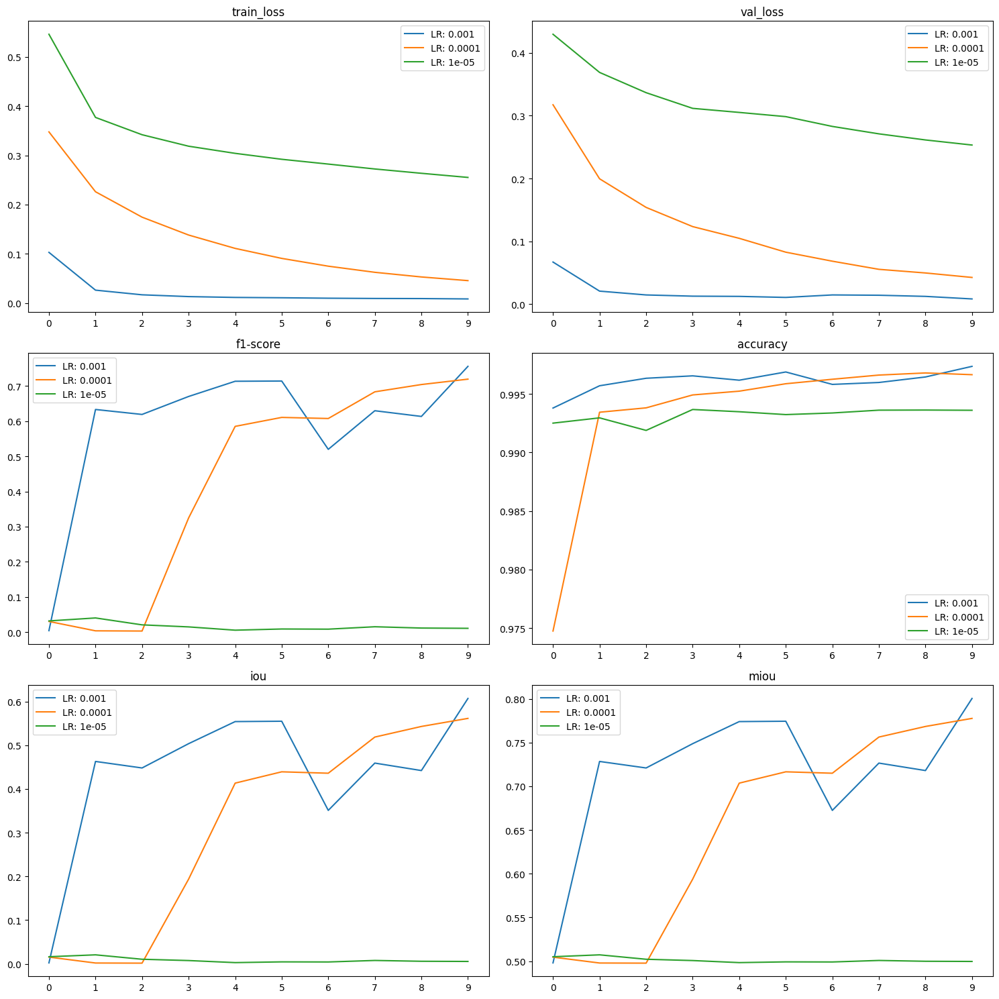

In [ ]:
num_rows = 3
num_cols = 2
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()
metrics = [key for key in checkpoint_dicts[0].keys() if key not in ['lr', 'checkpoint_path']]
# Loop over each metric and plot it with each learning rate
for i, metric in enumerate(metrics):
  for checkpoint_dict in checkpoint_dicts:
    lr = checkpoint_dict['lr']
    metric_data = checkpoint_dict[metric]
    epochs = range(len(metric_data))
    axes[i].plot(epochs, metric_data, label=f"LR: {lr}")
    axes[i].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    axes[i].set_title(metric)
    axes[i].legend()
  for j in range(len(metrics), num_rows * num_cols):
    axes[j].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
best_lr = 0.001

In [ ]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

#train baseline

In [ ]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
model_name = 'baseline'
model_trained_dir = os.path.join(model_dir, model_name)

if not os.path.exists(model_trained_dir):
    os.makedirs(model_trained_dir)

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), best_lr)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint come {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)

for epoch in range(num_epochs):  # Train for specified number of epochs
    if epoch <= start_epoch:
        print(f"Epoch {epoch+1} già esplorata per baseline train")
        continue

    print(f"Epoch {epoch+1}/{num_epochs}")

    epoch_train_loss = train(model, train_loader, optimizer, criterion, DEVICE)
    epoch_val_loss, y_true, y_pred = val(model, val_loader, criterion, DEVICE)

    f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

    name = f"{model_name}_epoch_{epoch}"

    train_loss.append(epoch_train_loss)
    val_loss.append(epoch_val_loss)
    f1_scores.append(f1_score)
    accuracy_scores.append(accuracy)
    miou_scores.append(miou)
    iou_scores.append(iou)

    save_model(model, optimizer, train_loss, val_loss, 'validation', best_lr,
                    f1_scores, accuracy_scores, iou_scores, miou_scores,
                    epoch, model_trained_dir, name)

    print(f'Epoch {epoch+1} train Loss: {epoch_train_loss:.4f} Validation loss: {epoch_val_loss:4f}')
    scheduler.step()
    if (epoch+1) == step_size:
        print("Scheduler debug")

    if epoch > 0:
        name = f"{model_name}_epoch_{epoch-1}"
        '''
        previous_checkpoint_path = os.path.join(model_trained_dir, f"{name}.pt")
        if os.path.exists(previous_checkpoint_path):
            os.remove(previous_checkpoint_path)
        '''

Epoch 1/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.64it/s, loss=0.0629]
<ipython-input-55-cc93e7081a04>:6: RuntimeWarning: invalid value encountered in scalar divide
  precision = tp / (tp + fp)


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_0.pt
Epoch 1 Training Loss: 0.1808 Validation loss: 0.062866
Epoch 2/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.39it/s, loss=0.0287]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_1.pt
Epoch 2 Training Loss: 0.0425 Validation loss: 0.028746
Epoch 3/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.0218]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_2.pt
Epoch 3 Training Loss: 0.0233 Validation loss: 0.021784
Epoch 4/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.40it/s, loss=0.0136]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_3.pt
Epoch 4 Training Loss: 0.0160 Validation loss: 0.013612
Epoch 5/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.62it/s, loss=0.0183]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_4.pt
Epoch 5 Training Loss: 0.0130 Validation loss: 0.018272
Epoch 6/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.36it/s, loss=0.0133]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_5.pt
Epoch 6 Training Loss: 0.0118 Validation loss: 0.013335
Epoch 7/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.0174]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_6.pt
Epoch 7 Training Loss: 0.0110 Validation loss: 0.017389
Epoch 8/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.36it/s, loss=0.0111]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_7.pt
Epoch 8 Training Loss: 0.0099 Validation loss: 0.011055
Epoch 9/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.00866]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_8.pt
Epoch 9 Training Loss: 0.0089 Validation loss: 0.008662
Epoch 10/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.38it/s, loss=0.00923]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_9.pt
Epoch 10 Training Loss: 0.0088 Validation loss: 0.009230
Epoch 11/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.0104]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_10.pt
Epoch 11 Training Loss: 0.0082 Validation loss: 0.010380
Epoch 12/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.36it/s, loss=0.0129]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_11.pt
Epoch 12 Training Loss: 0.0080 Validation loss: 0.012920
Epoch 13/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.62it/s, loss=0.00907]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_12.pt
Epoch 13 Training Loss: 0.0079 Validation loss: 0.009067
Epoch 14/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.38it/s, loss=0.00917]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_13.pt
Epoch 14 Training Loss: 0.0078 Validation loss: 0.009169
Epoch 15/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.0127]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_14.pt
Epoch 15 Training Loss: 0.0070 Validation loss: 0.012693
Epoch 16/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.36it/s, loss=0.00834]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_15.pt
Epoch 16 Training Loss: 0.0073 Validation loss: 0.008339
Epoch 17/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.58it/s, loss=0.00867]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_16.pt
Epoch 17 Training Loss: 0.0069 Validation loss: 0.008665
Epoch 18/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.34it/s, loss=0.00817]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_17.pt
Epoch 18 Training Loss: 0.0068 Validation loss: 0.008171
Epoch 19/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.0131]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_18.pt
Epoch 19 Training Loss: 0.0066 Validation loss: 0.013115
Epoch 20/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.30it/s, loss=0.0176]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_19.pt
Epoch 20 Training Loss: 0.0068 Validation loss: 0.017595
Epoch 21/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.0115]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_20.pt
Epoch 21 Training Loss: 0.0061 Validation loss: 0.011523
Epoch 22/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.34it/s, loss=0.0076]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_21.pt
Epoch 22 Training Loss: 0.0059 Validation loss: 0.007596
Epoch 23/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.56it/s, loss=0.00669]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_22.pt
Epoch 23 Training Loss: 0.0061 Validation loss: 0.006693
Epoch 24/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.32it/s, loss=0.00715]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_23.pt
Epoch 24 Training Loss: 0.0057 Validation loss: 0.007153
Epoch 25/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.53it/s, loss=0.00739]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_24.pt
Epoch 25 Training Loss: 0.0055 Validation loss: 0.007394
Epoch 26/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.32it/s, loss=0.00783]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_25.pt
Epoch 26 Training Loss: 0.0054 Validation loss: 0.007835
Epoch 27/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.55it/s, loss=0.00784]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_26.pt
Epoch 27 Training Loss: 0.0052 Validation loss: 0.007842
Scheduler debug
Epoch 28/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.34it/s, loss=0.0066]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_27.pt
Epoch 28 Training Loss: 0.0044 Validation loss: 0.006601
Epoch 29/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.55it/s, loss=0.00666]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_28.pt
Epoch 29 Training Loss: 0.0042 Validation loss: 0.006656
Epoch 30/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.33it/s, loss=0.00673]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_29.pt
Epoch 30 Training Loss: 0.0041 Validation loss: 0.006732


##Plotting

In [ ]:
model_name = 'baseline'
model_trained_dir = os.path.join(model_dir, model_name)

if not os.path.exists(model_trained_dir):
    os.makedirs(model_trained_dir)

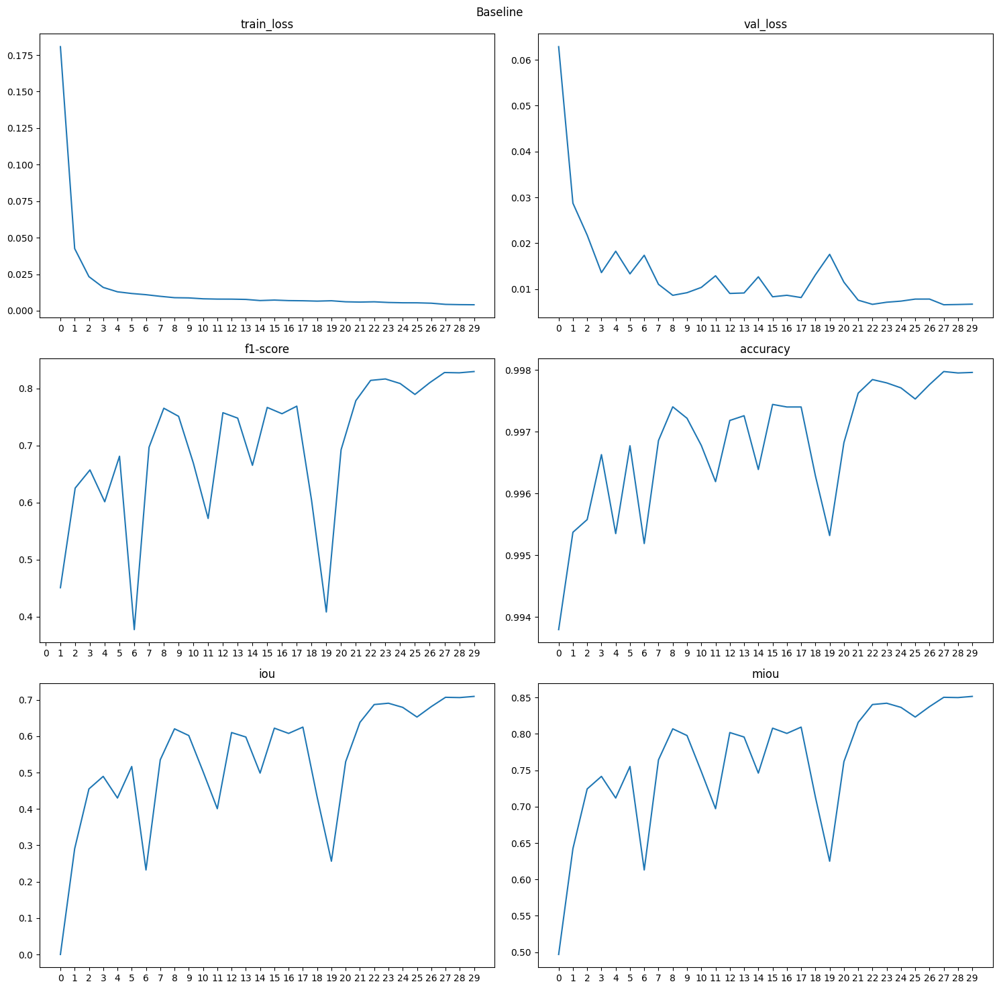

In [18]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline/baseline_epoch_29.pt'
stringa='Baseline'
plotting(checkpoint_path, stringa)

In [ ]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), 0.001)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint come {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)
model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
val_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(val_loader, desc='Validation', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)

    # Forward pass
    outputs = model(images)

            # Compute loss
    loss = criterion(outputs, masks)
    val_loss += loss.item()

            # Convert predictions to binary
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0

    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)

            # Update the progress bar description without causing wait
    data_iterator.set_postfix({'loss': val_loss / (batch_idx + 1)})

val_loss = val_loss / len(val_loader)

Carico checkpoint come baseline


Validation: 100%|██████████| 48/48 [00:17<00:00,  2.71it/s, loss=0.00673]


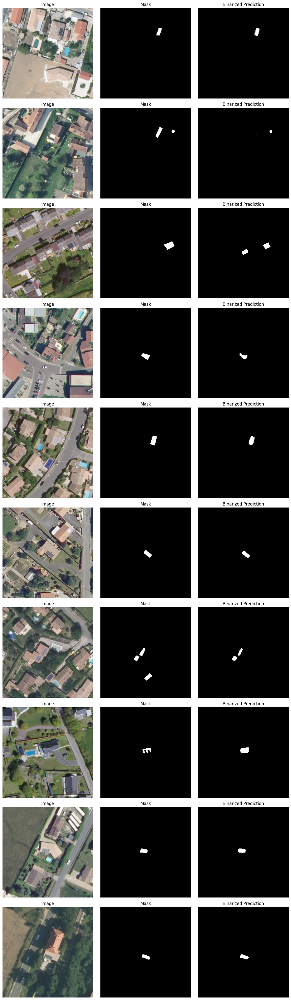

In [ ]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.4

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#train with data augmentation

In [ ]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
model_name = 'augmented'
model_trained_dir = os.path.join(model_dir, model_name)

if not os.path.exists(model_trained_dir):
    os.makedirs(model_trained_dir)

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"errore caricamwento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint esistente con {model_name}. inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), best_lr)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Caricato checkpoint con {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)

for epoch in range(num_epochs):  # Train for specified number of epochs
    if epoch <= start_epoch:
        print(f"Epoch {epoch+1} gia esplorata con aug ")
        continue

    print(f"Epoch {epoch+1}/{num_epochs}")

    epoch_train_loss = train(model, train_loader, optimizer, criterion, DEVICE)
    epoch_val_loss, y_true, y_pred = val(model, val_loader, criterion, DEVICE)

    f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

    name = f"{model_name}_epoch_{epoch}"

    train_loss.append(epoch_train_loss)
    val_loss.append(epoch_val_loss)
    f1_scores.append(f1_score)
    accuracy_scores.append(accuracy)
    miou_scores.append(miou)
    iou_scores.append(iou)

    save_model(model, optimizer, train_loss, val_loss, 'validation', best_lr,
                    f1_scores, accuracy_scores, iou_scores, miou_scores,
                    epoch, model_trained_dir, name)

    print(f'Epoch {epoch+1} train Loss: {epoch_train_loss:.4f} Validation loss: {epoch_val_loss:4f}')
    scheduler.step()
    if (epoch+1) == step_size:
        print("Scheduler debug")

    if epoch > 0:
        name = f"{model_name}_epoch_{epoch-1}"
        #previous_checkpoint_path = os.path.join(model_trained_dir, f"{name}.pt")
        #if os.path.exists(previous_checkpoint_path):
            #os.remove(previous_checkpoint_path)

Caricato checkpoint con augmented
Epoch 1 gia esplorata con aug 
Epoch 2/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.67it/s, loss=0.0271]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_1.pt
Epoch 2 Training Loss: 0.0360 Validation loss: 0.027107
Epoch 3/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.0181]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_2.pt
Epoch 3 Training Loss: 0.0206 Validation loss: 0.018122
Epoch 4/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.0142]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_3.pt
Epoch 4 Training Loss: 0.0155 Validation loss: 0.014245
Epoch 5/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.0206]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_4.pt
Epoch 5 Training Loss: 0.0128 Validation loss: 0.020593
Epoch 6/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.0163]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_5.pt
Epoch 6 Training Loss: 0.0117 Validation loss: 0.016313
Epoch 7/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.0209]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_6.pt
Epoch 7 Training Loss: 0.0107 Validation loss: 0.020901
Epoch 8/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.62it/s, loss=0.0116]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_7.pt
Epoch 8 Training Loss: 0.0102 Validation loss: 0.011595
Epoch 9/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.00955]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_8.pt
Epoch 9 Training Loss: 0.0097 Validation loss: 0.009552
Epoch 10/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.53it/s, loss=0.0124]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_9.pt
Epoch 10 Training Loss: 0.0091 Validation loss: 0.012402
Epoch 11/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.0097]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_10.pt
Epoch 11 Training Loss: 0.0091 Validation loss: 0.009698
Epoch 12/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.00835]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_11.pt
Epoch 12 Training Loss: 0.0090 Validation loss: 0.008353
Epoch 13/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.00836]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_12.pt
Epoch 13 Training Loss: 0.0086 Validation loss: 0.008359
Epoch 14/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.0119]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_13.pt
Epoch 14 Training Loss: 0.0086 Validation loss: 0.011856
Epoch 15/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.00926]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_14.pt
Epoch 15 Training Loss: 0.0086 Validation loss: 0.009258
Epoch 16/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.00869]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_15.pt
Epoch 16 Training Loss: 0.0083 Validation loss: 0.008695
Epoch 17/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.58it/s, loss=0.00846]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_16.pt
Epoch 17 Training Loss: 0.0081 Validation loss: 0.008459
Epoch 18/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.00883]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_17.pt
Epoch 18 Training Loss: 0.0078 Validation loss: 0.008833
Epoch 19/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.00922]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_18.pt
Epoch 19 Training Loss: 0.0077 Validation loss: 0.009224
Epoch 20/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.00771]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_19.pt
Epoch 20 Training Loss: 0.0083 Validation loss: 0.007710
Epoch 21/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.00887]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_20.pt
Epoch 21 Training Loss: 0.0079 Validation loss: 0.008875
Epoch 22/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.00732]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_21.pt
Epoch 22 Training Loss: 0.0077 Validation loss: 0.007317
Epoch 23/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.00744]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_22.pt
Epoch 23 Training Loss: 0.0077 Validation loss: 0.007444
Epoch 24/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.58it/s, loss=0.00884]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_23.pt
Epoch 24 Training Loss: 0.0073 Validation loss: 0.008845
Epoch 25/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.51it/s, loss=0.00886]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_24.pt
Epoch 25 Training Loss: 0.0072 Validation loss: 0.008860
Epoch 26/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.53it/s, loss=0.00955]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_25.pt
Epoch 26 Training Loss: 0.0071 Validation loss: 0.009549
Epoch 27/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.52it/s, loss=0.00726]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_26.pt
Epoch 27 Training Loss: 0.0070 Validation loss: 0.007262
Scheduler debug
Epoch 28/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.49it/s, loss=0.00672]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_27.pt
Epoch 28 Training Loss: 0.0073 Validation loss: 0.006719
Epoch 29/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.52it/s, loss=0.00653]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_28.pt
Epoch 29 Training Loss: 0.0062 Validation loss: 0.006533
Epoch 30/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.50it/s, loss=0.00664]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_29.pt
Epoch 30 Training Loss: 0.0061 Validation loss: 0.006636


##Plotting

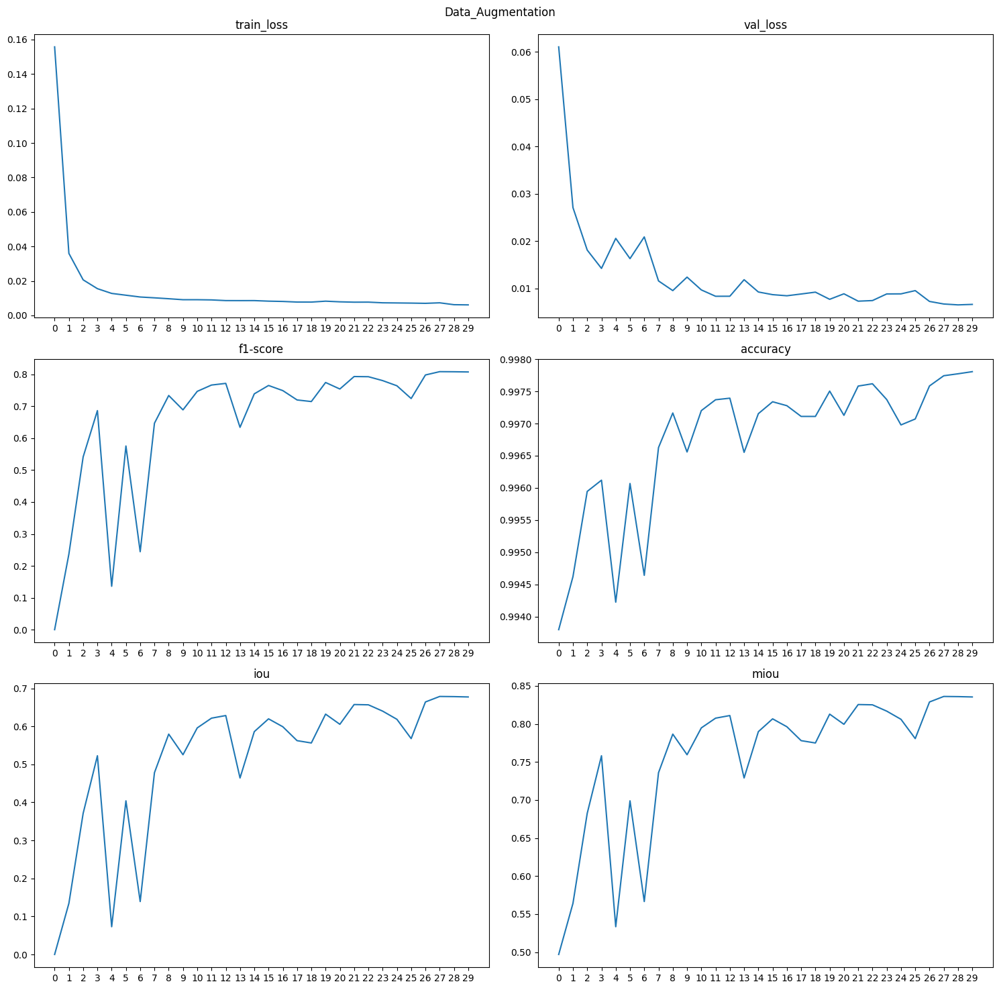

In [19]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_29.pt'
stringa='Data_Augmentation'
plotting(checkpoint_path, stringa)

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented/augmented_epoch_29.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.15574228903278708, 0.03596464447521915, 0.020635231482123748, 0.01551897904654551, 0.012764738238830533, 0.011718553549144417, 0.010681108872328574, 0.01020575733208615, 0.009680013431029188, 0.009111322262065692, 0.009114342880719859, 0.008998087785180865, 0.008604938930754239, 0.008584879558636911, 0.008598409961753836, 0.008279963535541255, 0.008105956114983806, 0.007755316502880305, 0.007737429330720463, 0.008267609599796642, 0.007887968690031104, 0.007684446350645481, 0.007712559580492477, 0.007322358138885142, 0.007236857968059162, 0.007149557117372751, 0.007012197679917638, 0.007317324314499274, 0.006221784345042478, 0.00611714781067955]
type loss: validation
Validation Loss: [0.06108684294546644, 0.027106598019599915, 0.018122034166784335, 0.014245383984719714, 0.02059292948494355, 0.01631269904707248, 0.02090134013754626, 0.011595332509993264, 0.009551949731151884, 0.012401640812944, 0.009698002346946547, 0.008353230688953772, 0.008359487246

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), 0.001)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint come {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)
model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
val_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(val_loader, desc='Validation', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)

    # Forward pass
    outputs = model(images)

            # Compute loss
    loss = criterion(outputs, masks)
    val_loss += loss.item()

            # Convert predictions to binary
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0

    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)

            # Update the progress bar description without causing wait
    data_iterator.set_postfix({'loss': val_loss / (batch_idx + 1)})





Carico checkpoint come augmented


Validation: 100%|██████████| 48/48 [00:19<00:00,  2.50it/s, loss=0.00664]


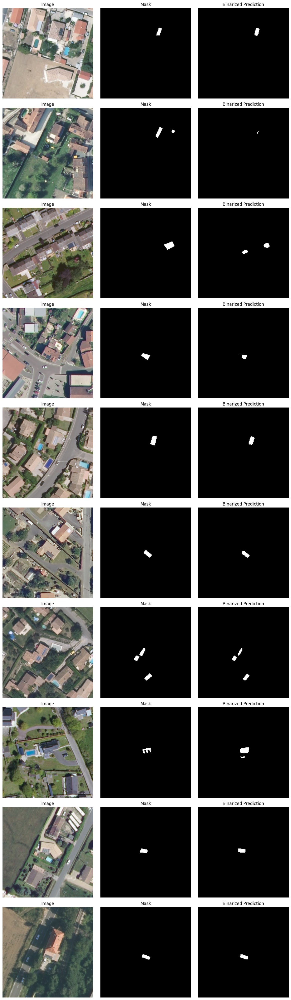

In [ ]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.4

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#train with data augmentation and weight

In [ ]:
import os
from PIL import Image
import numpy as np

def count_white_and_black_pixels_in_directory(directory):
    # Inizializza i conteggi totali
    total_white_pixels = 0
    total_black_pixels = 0

    # Itera su tutte le immagini nella directory
    for filename in os.listdir(directory):
        # Ottieni il percorso completo dell'immagine
        image_path = os.path.join(directory, filename)

        # Apri l'immagine utilizzando PIL
        img = Image.open(image_path)

        # Converti l'immagine in un array numpy
        img_array = np.array(img)

        # Conta i pixel bianchi (255) e neri (0)
        white_pixels = np.sum(img_array == 255)
        black_pixels = np.sum(img_array == 0)

        # Aggiorna i conteggi totali
        total_white_pixels += white_pixels
        total_black_pixels += black_pixels

    return total_white_pixels, total_black_pixels

# Utilizzo della funzione per la directory specificata
directory = "/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/train/mask/"
white_pixels, black_pixels = count_white_and_black_pixels_in_directory(directory)
print("Pixel bianchi totali:", white_pixels)
print("Pixel neri totali:", black_pixels)
print("Rapporto pixel neri / pixel bianchi:", black_pixels / white_pixels)
weight = black_pixels / white_pixels
print(weight)

Pixel bianchi totali: 4291140
Pixel neri totali: 732988860
Rapporto pixel neri / pixel bianchi: 170.8144828646933
170.8144828646933


In [16]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
model_name = 'augmented_with_weight'
model_trained_dir = os.path.join(model_dir, model_name)

if not os.path.exists(model_trained_dir):
    os.makedirs(model_trained_dir)

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"errore checkpoint su {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), best_lr)
weight = 170.8144828646933
criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(weight).to(DEVICE))
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint con {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)

for epoch in range(num_epochs):  # Train for specified number of epochs
    if epoch <= start_epoch:
        print(f"Epoch {epoch+1} gia esplorata per aug con peso")
        continue

    print(f"Epoch {epoch+1}/{num_epochs}")

    epoch_train_loss = train(model, train_loader, optimizer, criterion, DEVICE)
    epoch_val_loss, y_true, y_pred = val(model, val_loader, criterion, DEVICE)

    f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

    name = f"{model_name}_epoch_{epoch}"

    train_loss.append(epoch_train_loss)
    val_loss.append(epoch_val_loss)
    f1_scores.append(f1_score)
    accuracy_scores.append(accuracy)
    miou_scores.append(miou)
    iou_scores.append(iou)

    save_model(model, optimizer, train_loss, val_loss, 'validation', best_lr,
                    f1_scores, accuracy_scores, iou_scores, miou_scores,
                    epoch, model_trained_dir, name)

    print(f'Epoch {epoch+1} train Loss: {epoch_train_loss:.4f} Validation loss: {epoch_val_loss:4f}')
    scheduler.step()
    if (epoch+1) == step_size:
        print("Scheduler debug")

    if epoch > 0:
        name = f"{model_name}_epoch_{epoch-1}"
        '''
        previous_checkpoint_path = os.path.join(model_trained_dir, f"{name}.pt")
        if os.path.exists(previous_checkpoint_path):
            os.remove(previous_checkpoint_path)
        '''

Epoch 1/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.496]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_0.pt
Epoch 1 Training Loss: 0.4867 Validation loss: 0.495600
Epoch 2/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.47it/s, loss=0.283]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_1.pt
Epoch 2 Training Loss: 0.3182 Validation loss: 0.282666
Epoch 3/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.357]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_2.pt
Epoch 3 Training Loss: 0.2968 Validation loss: 0.356740
Epoch 4/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.41it/s, loss=0.276]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_3.pt
Epoch 4 Training Loss: 0.2620 Validation loss: 0.275829
Epoch 5/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.26]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_4.pt
Epoch 5 Training Loss: 0.2573 Validation loss: 0.260222
Epoch 6/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.41it/s, loss=0.341]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_5.pt
Epoch 6 Training Loss: 0.2323 Validation loss: 0.341217
Epoch 7/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.59it/s, loss=0.26]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_6.pt
Epoch 7 Training Loss: 0.2470 Validation loss: 0.260133
Epoch 8/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.43it/s, loss=0.508]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_7.pt
Epoch 8 Training Loss: 0.2644 Validation loss: 0.508291
Epoch 9/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.224]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_8.pt
Epoch 9 Training Loss: 0.2437 Validation loss: 0.223929
Epoch 10/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.39it/s, loss=0.268]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_9.pt
Epoch 10 Training Loss: 0.2288 Validation loss: 0.268435
Epoch 11/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.55it/s, loss=0.252]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_10.pt
Epoch 11 Training Loss: 0.2365 Validation loss: 0.251766
Epoch 12/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.39it/s, loss=0.205]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_11.pt
Epoch 12 Training Loss: 0.2324 Validation loss: 0.205084
Epoch 13/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.257]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_12.pt
Epoch 13 Training Loss: 0.2098 Validation loss: 0.256560
Epoch 14/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.39it/s, loss=0.325]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_13.pt
Epoch 14 Training Loss: 0.2538 Validation loss: 0.325074
Epoch 15/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.55it/s, loss=0.241]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_14.pt
Epoch 15 Training Loss: 0.2040 Validation loss: 0.240853
Epoch 16/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.40it/s, loss=0.289]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_15.pt
Epoch 16 Training Loss: 0.2066 Validation loss: 0.289406
Epoch 17/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.58it/s, loss=0.303]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_16.pt
Epoch 17 Training Loss: 0.2008 Validation loss: 0.303050
Epoch 18/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.38it/s, loss=0.223]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_17.pt
Epoch 18 Training Loss: 0.2167 Validation loss: 0.222701
Epoch 19/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.216]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_18.pt
Epoch 19 Training Loss: 0.2054 Validation loss: 0.215786
Epoch 20/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.45it/s, loss=0.2]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_19.pt
Epoch 20 Training Loss: 0.1844 Validation loss: 0.200349
Epoch 21/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.41it/s, loss=0.389]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_20.pt
Epoch 21 Training Loss: 0.2015 Validation loss: 0.388683
Epoch 22/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.47it/s, loss=0.232]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_21.pt
Epoch 22 Training Loss: 0.2014 Validation loss: 0.231638
Epoch 23/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.204]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_22.pt
Epoch 23 Training Loss: 0.1831 Validation loss: 0.204357
Epoch 24/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.45it/s, loss=0.2]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_23.pt
Epoch 24 Training Loss: 0.1818 Validation loss: 0.200154
Epoch 25/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.309]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_24.pt
Epoch 25 Training Loss: 0.1982 Validation loss: 0.308674
Epoch 26/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.43it/s, loss=0.177]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_25.pt
Epoch 26 Training Loss: 0.1722 Validation loss: 0.177473
Epoch 27/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.216]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_26.pt
Epoch 27 Training Loss: 0.1782 Validation loss: 0.215887
Scheduler debug
Epoch 28/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.44it/s, loss=0.188]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_27.pt
Epoch 28 Training Loss: 0.1746 Validation loss: 0.187921
Epoch 29/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.175]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_28.pt
Epoch 29 Training Loss: 0.1606 Validation loss: 0.174744
Epoch 30/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.43it/s, loss=0.181]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_29.pt
Epoch 30 Training Loss: 0.1525 Validation loss: 0.181486


##Plotting

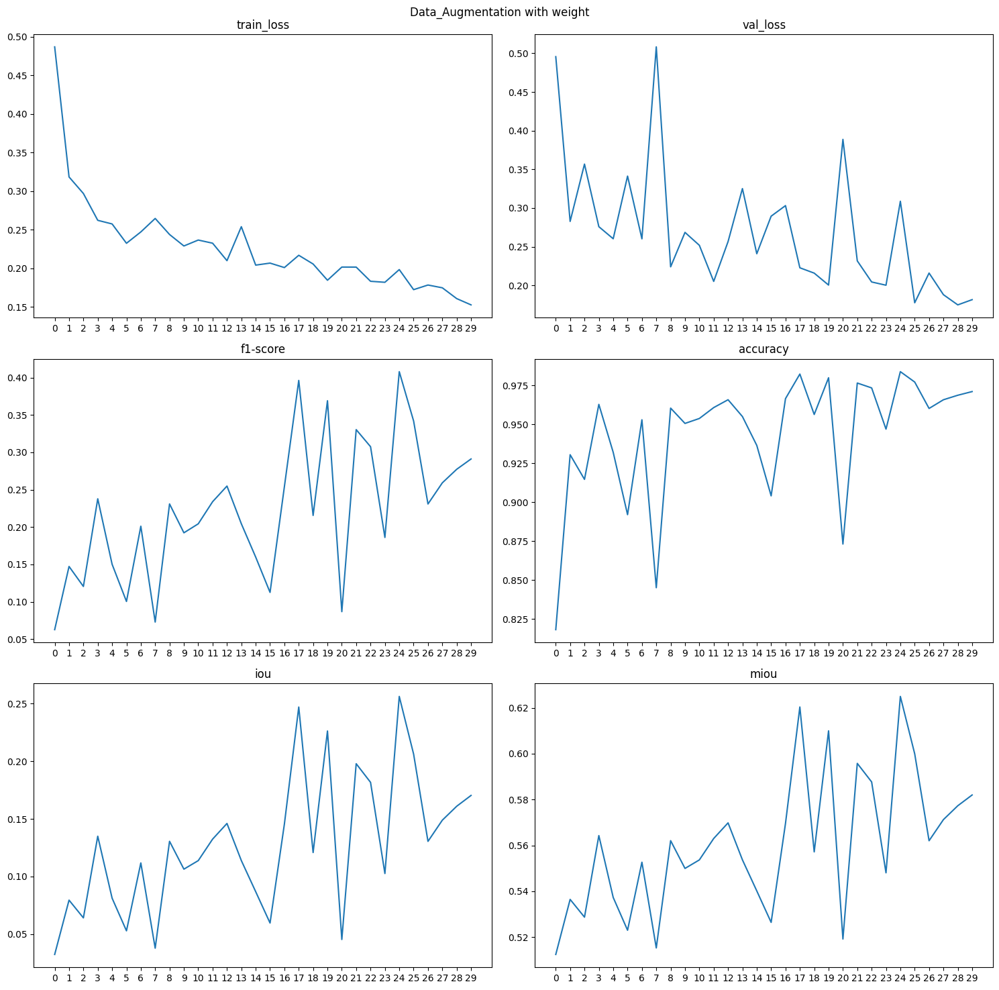

In [20]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_29.pt'
stringa='Data_Augmentation with weight'
plotting(checkpoint_path, stringa)

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/augmented_with_weight/augmented_with_weight_epoch_29.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.48668372517244685, 0.31820198076052797, 0.29676625815530616, 0.2620250725497802, 0.2573293573740456, 0.23229482014560038, 0.24698210574893487, 0.2644357064531909, 0.24367823493149546, 0.22879915855204067, 0.2364807998140653, 0.23238865834557348, 0.20978495095753008, 0.25377906093166935, 0.2040095669734809, 0.2066185598054694, 0.20084568144132695, 0.21674846609433493, 0.20543955442392164, 0.1844238170629574, 0.20147847777439487, 0.20143804016212621, 0.18307782595770228, 0.1817659392642478, 0.19822427242373428, 0.17222438023115197, 0.1782281151972711, 0.17462433057112825, 0.16064851813846165, 0.15251463760311404]
type loss: validation
Validation Loss: [0.49559970448414487, 0.2826655100410183, 0.3567397103955348, 0.2758290401349465, 0.26022247566531104, 0.3412171136587858, 0.2601333778972427, 0.5082907397300005, 0.223928547774752, 0.2684353155394395, 0.25176639777297777, 0.20508441096171737, 0.2565598826234539, 0.3250742970655362, 0.24085334843645492, 0

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), 0.001)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint come {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)
model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
val_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(val_loader, desc='Validation', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)

    # Forward pass
    outputs = model(images)

            # Compute loss
    loss = criterion(outputs, masks)
    val_loss += loss.item()

            # Convert predictions to binary
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0

    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)

            # Update the progress bar description without causing wait
    data_iterator.set_postfix({'loss': val_loss / (batch_idx + 1)})

val_loss = val_loss / len(val_loader)



Carico checkpoint come augmented_with_weight


Validation: 100%|██████████| 48/48 [00:17<00:00,  2.78it/s, loss=0.082]


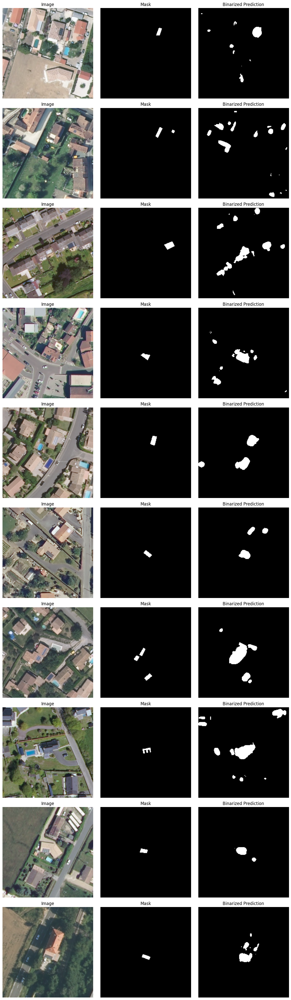

In [ ]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.4

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#Test Baseline

In [16]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [20]:
model_name = 'baseline'
model_trained_dir = os.path.join(model_dir, model_name)

# Imposta il nome specifico del checkpoint desiderato
specific_checkpoint_name = 'baseline_epoch_29.pt'

# Percorso completo del checkpoint desiderato
specific_checkpoint_path = os.path.join(model_trained_dir, specific_checkpoint_name)

# Verifica se il checkpoint specifico esiste
if os.path.exists(specific_checkpoint_path):
    try:
        # Carica il checkpoint specifico
        checkpoint = torch.load(specific_checkpoint_path, map_location=torch.device('cpu'))
        train_loss = checkpoint['train_loss']
        val_loss = checkpoint['other_loss']
        f1_scores = checkpoint['f1-score']
        accuracy_scores = checkpoint['accuracy']
        iou_scores = checkpoint['iou']
        miou_scores = checkpoint['miou']
        start_epoch = checkpoint['epoch']
        model_state_dict = checkpoint['model_state_dict']
        optimizer_state_dict = checkpoint['optimizer_state_dict']

        # Stampa un messaggio informativo
        print(f"Caricato il checkpoint specifico: {specific_checkpoint_name}")

    except Exception as e:
        print(f"Errore durante il caricamento del checkpoint specifico: {e}")
else:
    print(f"Checkpoint specifico non trovato: {specific_checkpoint_path}")

model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
test_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(test_loader, desc='test', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)
    outputs = model(images)
    '''
    loss = criterion(outputs, masks)
    test_loss += loss.item()
    '''
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0
    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)
    data_iterator.set_postfix({'loss': test_loss / (batch_idx + 1)})

f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

Caricato il checkpoint specifico: baseline_epoch_27.pt


test: 100%|██████████| 49/49 [00:17<00:00,  2.76it/s, loss=0]
<ipython-input-13-d5492d2bc817>:6: RuntimeWarning: invalid value encountered in scalar divide
  precision = tp / (tp + fp)


In [18]:
print("MODEL METRICS")
# Definisci i nomi dei campi desiderati
campi_desiderati = ['f1-score', 'iou','miou','accuracy','train_loss']

# Itera su tutti i campi desiderati
for campo in campi_desiderati:
    # Verifica se il campo è presente nel checkpoint
    if campo in checkpoint:
        # Accedi all'ultimo elemento del campo
        last_element = checkpoint[campo][-1]
        # Stampa l'ultimo elemento del campo
        print(f"{campo} : {last_element}")

MODEL METRICS
f1-score : 0.8299194243699948
iou : 0.7092839943293154
miou : 0.8515369770408147
accuracy : 0.9979607634338139
train_loss : 0.004098399518018899


In [19]:
print("TEST METRICS")
print(f"f1_score : {f1_score}")
print(f"iou : '{iou}")
print(f"miou : '{miou}")
print(f"acc : '{accuracy}")
#print(f"testloss : '{test_loss/len(test_loader)}")

TEST METRICS
f1_score : nan
iou : '0.0
miou : '0.49656503062540297
acc : '0.9931300612508059


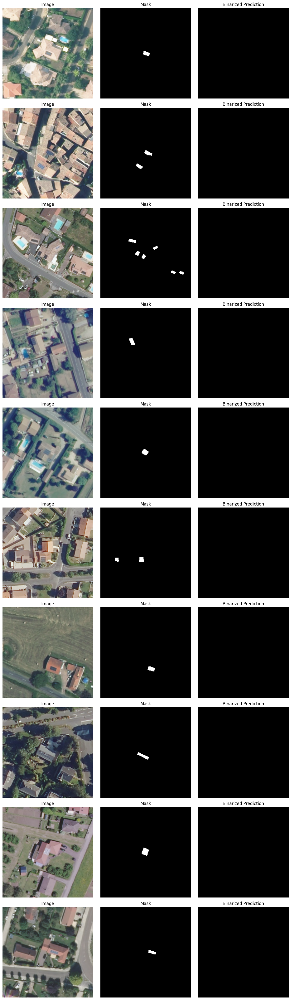

In [18]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.5

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#Test Baseline with weight

In [21]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [22]:
model_name = 'baseline_with_weight'
model_trained_dir = os.path.join(model_dir, model_name)

# Imposta il nome specifico del checkpoint desiderato
specific_checkpoint_name = 'baseline_epoch_29.pt'

# Percorso completo del checkpoint desiderato
specific_checkpoint_path = os.path.join(model_trained_dir, specific_checkpoint_name)

# Verifica se il checkpoint specifico esiste
if os.path.exists(specific_checkpoint_path):
    try:
        # Carica il checkpoint specifico
        checkpoint = torch.load(specific_checkpoint_path, map_location=torch.device('cpu'))
        train_loss = checkpoint['train_loss']
        val_loss = checkpoint['other_loss']
        f1_scores = checkpoint['f1-score']
        accuracy_scores = checkpoint['accuracy']
        iou_scores = checkpoint['iou']
        miou_scores = checkpoint['miou']
        start_epoch = checkpoint['epoch']
        model_state_dict = checkpoint['model_state_dict']
        optimizer_state_dict = checkpoint['optimizer_state_dict']

        # Stampa un messaggio informativo
        print(f"Caricato il checkpoint specifico: {specific_checkpoint_name}")

    except Exception as e:
        print(f"Errore durante il caricamento del checkpoint specifico: {e}")
else:
    print(f"Checkpoint specifico non trovato: {specific_checkpoint_path}")

model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
test_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(test_loader, desc='test', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)
    outputs = model(images)
    '''
    loss = criterion(outputs, masks)
    test_loss += loss.item()
    '''
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0
    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)
    data_iterator.set_postfix({'loss': test_loss / (batch_idx + 1)})

f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

Checkpoint specifico non trovato: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_epoch_29.pt


test: 100%|██████████| 49/49 [00:17<00:00,  2.81it/s, loss=0]
<ipython-input-13-d5492d2bc817>:6: RuntimeWarning: invalid value encountered in scalar divide
  precision = tp / (tp + fp)


In [23]:
print("MODEL METRICS")
# Definisci i nomi dei campi desiderati
campi_desiderati = ['f1-score', 'iou','miou','accuracy','train_loss']

# Itera su tutti i campi desiderati
for campo in campi_desiderati:
    # Verifica se il campo è presente nel checkpoint
    if campo in checkpoint:
        # Accedi all'ultimo elemento del campo
        last_element = checkpoint[campo][-1]
        # Stampa l'ultimo elemento del campo
        print(f"{campo} : {last_element}")

MODEL METRICS
f1-score : 0.8299194243699948
iou : 0.7092839943293154
miou : 0.8515369770408147
accuracy : 0.9979607634338139
train_loss : 0.004098399518018899


In [24]:
print("TEST METRICS")
print(f"f1_score : {f1_score}")
print(f"iou : '{iou}")
print(f"miou : '{miou}")
print(f"acc : '{accuracy}")
#print(f"testloss : '{test_loss/len(test_loader)}")

TEST METRICS
f1_score : nan
iou : '0.0
miou : '0.49656503062540297
acc : '0.9931300612508059


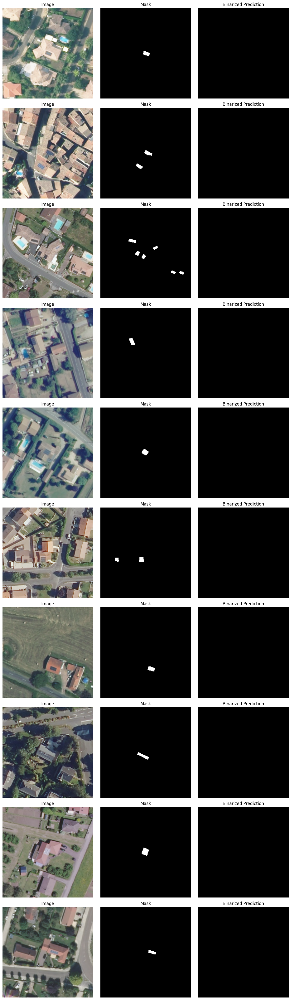

In [25]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.5

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#Test Data Augmentation

In [26]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [29]:
model_name = 'augmented'
model_trained_dir = os.path.join(model_dir, model_name)

# Imposta il nome specifico del checkpoint desiderato
specific_checkpoint_name = 'augmented_epoch_29.pt'

# Percorso completo del checkpoint desiderato
specific_checkpoint_path = os.path.join(model_trained_dir, specific_checkpoint_name)

# Verifica se il checkpoint specifico esiste
if os.path.exists(specific_checkpoint_path):
    try:
        # Carica il checkpoint specifico
        checkpoint = torch.load(specific_checkpoint_path, map_location=torch.device('cpu'))
        train_loss = checkpoint['train_loss']
        val_loss = checkpoint['other_loss']
        f1_scores = checkpoint['f1-score']
        accuracy_scores = checkpoint['accuracy']
        iou_scores = checkpoint['iou']
        miou_scores = checkpoint['miou']
        start_epoch = checkpoint['epoch']
        model_state_dict = checkpoint['model_state_dict']
        optimizer_state_dict = checkpoint['optimizer_state_dict']

        # Stampa un messaggio informativo
        print(f"Caricato il checkpoint specifico: {specific_checkpoint_name}")

    except Exception as e:
        print(f"Errore durante il caricamento del checkpoint specifico: {e}")
else:
    print(f"Checkpoint specifico non trovato: {specific_checkpoint_path}")

model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
test_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(test_loader, desc='test', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)
    outputs = model(images)
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0
    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)
    data_iterator.set_postfix({'loss': test_loss / (batch_idx + 1)})

f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

Caricato il checkpoint specifico: augmented_epoch_29.pt


test: 100%|██████████| 49/49 [00:13<00:00,  3.65it/s, loss=0]
<ipython-input-13-d5492d2bc817>:6: RuntimeWarning: invalid value encountered in scalar divide
  precision = tp / (tp + fp)


In [30]:
print("MODEL METRICS")
# Definisci i nomi dei campi desiderati
campi_desiderati = ['f1-score', 'iou','miou','accuracy','train_loss']

# Itera su tutti i campi desiderati
for campo in campi_desiderati:
    # Verifica se il campo è presente nel checkpoint
    if campo in checkpoint:
        # Accedi all'ultimo elemento del campo
        last_element = checkpoint[campo][-1]
        # Stampa l'ultimo elemento del campo
        print(f"{campo} : {last_element}")

MODEL METRICS
f1-score : 0.8075743156405707
iou : 0.6772533720408744
miou : 0.8355223496176887
accuracy : 0.9978071100917432
train_loss : 0.00611714781067955


In [31]:
print("TEST METRICS")
print(f"f1_score : {f1_score}")
print(f"iou : '{iou}")
print(f"miou : '{miou}")
print(f"acc : '{accuracy}")
#print(f"testloss : '{test_loss/len(test_loader)}")

TEST METRICS
f1_score : nan
iou : '0.0
miou : '0.49656503062540297
acc : '0.9931300612508059


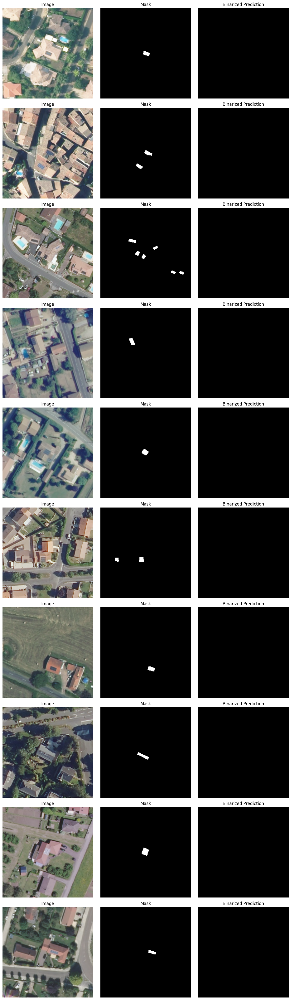

In [32]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.5

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#Test Data augmentation with weight

In [ ]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
model_name = 'augmented_with_weight'
model_trained_dir = os.path.join(model_dir, model_name)

# Imposta il nome specifico del checkpoint desiderato
specific_checkpoint_name = 'augmented_with_weight_epoch_24.pt'

# Percorso completo del checkpoint desiderato
specific_checkpoint_path = os.path.join(model_trained_dir, specific_checkpoint_name)

# Verifica se il checkpoint specifico esiste
if os.path.exists(specific_checkpoint_path):
    try:
        # Carica il checkpoint specifico
        checkpoint = torch.load(specific_checkpoint_path, map_location=torch.device('cpu'))
        train_loss = checkpoint['train_loss']
        val_loss = checkpoint['other_loss']
        f1_scores = checkpoint['f1-score']
        accuracy_scores = checkpoint['accuracy']
        iou_scores = checkpoint['iou']
        miou_scores = checkpoint['miou']
        start_epoch = checkpoint['epoch']
        model_state_dict = checkpoint['model_state_dict']
        optimizer_state_dict = checkpoint['optimizer_state_dict']

        # Stampa un messaggio informativo
        print(f"Caricato il checkpoint specifico: {specific_checkpoint_name}")

    except Exception as e:
        print(f"Errore durante il caricamento del checkpoint specifico: {e}")
else:
    print(f"Checkpoint specifico non trovato: {specific_checkpoint_path}")

model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
test_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(test_loader, desc='test', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)
    outputs = model(images)
    '''
    loss = criterion(outputs, masks)
    test_loss += loss.item()
    '''
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0
    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)
    data_iterator.set_postfix({'loss': test_loss / (batch_idx + 1)})

f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

In [39]:
print("MODEL METRICS")
# Definisci i nomi dei campi desiderati
campi_desiderati = ['f1-score', 'iou','miou','accuracy','train_loss']

# Itera su tutti i campi desiderati
for campo in campi_desiderati:
    # Verifica se il campo è presente nel checkpoint
    if campo in checkpoint:
        # Accedi all'ultimo elemento del campo
        last_element = checkpoint[campo][-1]
        # Stampa l'ultimo elemento del campo
        print(f"{campo} : {last_element}")


MODEL METRICS
f1-score : 0.4080127889083113
iou : 0.2562914991185895
miou : 0.6249940256148769
accuracy : 0.983771510484928
train_loss : 0.19822427242373428


In [38]:
print("TEST METRICS")
print(f"f1_score : {f1_score}")
print(f"iou : '{iou}")
print(f"miou : '{miou}")
print(f"acc : '{accuracy}")
#print(f"testloss : '{test_loss/len(test_loader)}")

TEST METRICS
f1_score : 0.31107054262895056
iou : '0.18418208130087096
miou : '0.5885523640378257
acc : '0.9704863797549967


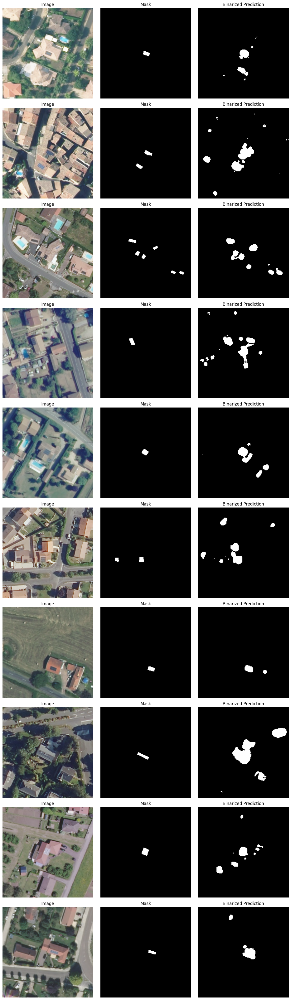

In [40]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.5

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

#Call train

##Train baseline with weight

In [40]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [ ]:
model_name = 'baseline_with_weight'
model_trained_dir = os.path.join(model_dir, model_name)

if not os.path.exists(model_trained_dir):
    os.makedirs(model_trained_dir)

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"errore checkpoint su {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), best_lr)
weight = 170.8144828646933
criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(weight).to(DEVICE))
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint con {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)

for epoch in range(num_epochs):  # Train for specified number of epochs
    if epoch <= start_epoch:
        print(f"Epoch {epoch+1} gia esplorata per aug con peso")
        continue

    print(f"Epoch {epoch+1}/{num_epochs}")

    epoch_train_loss = train(model, train_loader, optimizer, criterion, DEVICE)
    epoch_val_loss, y_true, y_pred = val(model, val_loader, criterion, DEVICE)

    f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

    name = f"{model_name}_epoch_{epoch}"

    train_loss.append(epoch_train_loss)
    val_loss.append(epoch_val_loss)
    f1_scores.append(f1_score)
    accuracy_scores.append(accuracy)
    miou_scores.append(miou)
    iou_scores.append(iou)

    save_model(model, optimizer, train_loss, val_loss, 'validation', best_lr,
                    f1_scores, accuracy_scores, iou_scores, miou_scores,
                    epoch, model_trained_dir, name)

    print(f'Epoch {epoch+1} train Loss: {epoch_train_loss:.4f} Validation loss: {epoch_val_loss:4f}')
    scheduler.step()
    if (epoch+1) == step_size:
        print("Scheduler debug")

    if epoch > 0:
        name = f"{model_name}_epoch_{epoch-1}"
        '''
        previous_checkpoint_path = os.path.join(model_trained_dir, f"{name}.pt")
        if os.path.exists(previous_checkpoint_path):
            os.remove(previous_checkpoint_path)
        '''

Epoch 1/30


Validation: 100%|██████████| 48/48 [00:14<00:00,  3.39it/s, loss=0.602]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_0.pt
Epoch 1 Training Loss: 0.5018 Validation loss: 0.602313
Epoch 2/30


Validation: 100%|██████████| 48/48 [00:12<00:00,  3.70it/s, loss=0.494]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_1.pt
Epoch 2 Training Loss: 0.3047 Validation loss: 0.494473
Epoch 3/30


Validation: 100%|██████████| 48/48 [00:12<00:00,  3.71it/s, loss=0.306]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_2.pt
Epoch 3 Training Loss: 0.2723 Validation loss: 0.306214
Epoch 4/30


Validation: 100%|██████████| 48/48 [00:12<00:00,  3.71it/s, loss=0.372]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_3.pt
Epoch 4 Training Loss: 0.2623 Validation loss: 0.372248
Epoch 5/30


Validation: 100%|██████████| 48/48 [00:12<00:00,  3.70it/s, loss=0.231]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_4.pt
Epoch 5 Training Loss: 0.2157 Validation loss: 0.231121
Epoch 6/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.57it/s, loss=0.286]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_5.pt
Epoch 6 Training Loss: 0.2567 Validation loss: 0.286377
Epoch 7/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.69it/s, loss=0.266]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_6.pt
Epoch 7 Training Loss: 0.2261 Validation loss: 0.265548
Epoch 8/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.69it/s, loss=0.314]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_7.pt
Epoch 8 Training Loss: 0.1989 Validation loss: 0.313750
Epoch 9/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.66it/s, loss=1.04]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_8.pt
Epoch 9 Training Loss: 0.1780 Validation loss: 1.042621
Epoch 10/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.67it/s, loss=0.233]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_9.pt
Epoch 10 Training Loss: 0.1842 Validation loss: 0.232849
Epoch 11/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.67it/s, loss=0.206]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_10.pt
Epoch 11 Training Loss: 0.1870 Validation loss: 0.206279
Epoch 12/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.54it/s, loss=0.217]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_11.pt
Epoch 12 Training Loss: 0.1683 Validation loss: 0.216790
Epoch 13/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.227]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_12.pt
Epoch 13 Training Loss: 0.1480 Validation loss: 0.227063
Epoch 14/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.189]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_13.pt
Epoch 14 Training Loss: 0.1436 Validation loss: 0.188546
Epoch 15/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.235]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_14.pt
Epoch 15 Training Loss: 0.1733 Validation loss: 0.235443
Epoch 16/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.66it/s, loss=0.566]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_15.pt
Epoch 16 Training Loss: 0.1509 Validation loss: 0.565744
Epoch 17/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.748]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_16.pt
Epoch 17 Training Loss: 0.1421 Validation loss: 0.748068
Epoch 18/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.202]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_17.pt
Epoch 18 Training Loss: 0.2327 Validation loss: 0.202380
Epoch 19/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.244]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_18.pt
Epoch 19 Training Loss: 0.1467 Validation loss: 0.243840
Epoch 20/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.67it/s, loss=0.208]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_19.pt
Epoch 20 Training Loss: 0.1415 Validation loss: 0.208341
Epoch 21/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.64it/s, loss=0.191]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_20.pt
Epoch 21 Training Loss: 0.1259 Validation loss: 0.190760
Epoch 22/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.65it/s, loss=0.234]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_21.pt
Epoch 22 Training Loss: 0.1119 Validation loss: 0.234175
Epoch 23/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.25]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_22.pt
Epoch 23 Training Loss: 0.1156 Validation loss: 0.249963
Epoch 24/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.185]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_23.pt
Epoch 24 Training Loss: 0.1151 Validation loss: 0.185451
Epoch 25/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.63it/s, loss=0.195]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_24.pt
Epoch 25 Training Loss: 0.1024 Validation loss: 0.194825
Epoch 26/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.60it/s, loss=0.214]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_25.pt
Epoch 26 Training Loss: 0.0999 Validation loss: 0.214279
Epoch 27/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.192]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_26.pt
Epoch 27 Training Loss: 0.0852 Validation loss: 0.191520
Scheduler debug
Epoch 28/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.62it/s, loss=0.196]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_27.pt
Epoch 28 Training Loss: 0.0717 Validation loss: 0.195800
Epoch 29/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.61it/s, loss=0.206]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_28.pt
Epoch 29 Training Loss: 0.0672 Validation loss: 0.205823
Epoch 30/30


Validation: 100%|██████████| 48/48 [00:13<00:00,  3.51it/s, loss=0.219]


Saved checkpoint: /content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_29.pt
Epoch 30 Training Loss: 0.0630 Validation loss: 0.218996


##Plotting

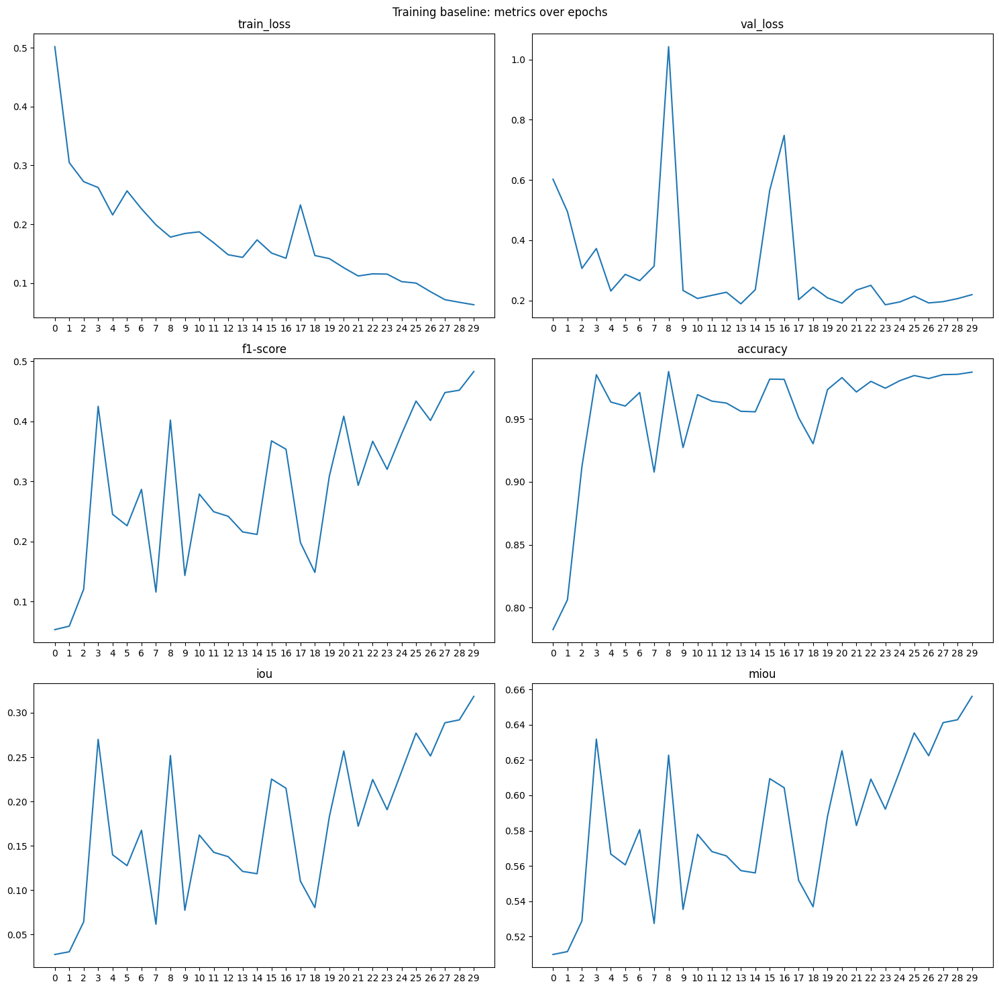

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_29.pt'

checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
checkpoint_dict = {
    'checkpoint_path': checkpoint_path,
    'train_loss': checkpoint['train_loss'],
    'val_loss': checkpoint['other_loss'],
    'f1-score': checkpoint['f1-score'],
    'accuracy': checkpoint['accuracy'],
    'iou': checkpoint['iou'],
    'miou': checkpoint['miou'],
    'lr': checkpoint['lr']
}


num_rows = 3
num_cols = 2

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
axes = axes.flatten()

metrics = [key for key in checkpoint_dict.keys() if key not in ['lr', 'checkpoint_path']]

# Loop over each metric and plot it with each learning rate
for i, metric in enumerate(metrics):
  metric_data = checkpoint_dict[metric]
  epochs = range(len(metric_data))
  axes[i].plot(epochs, metric_data)

  # Set integer ticks for x-axis
  axes[i].xaxis.set_major_locator(plt.MaxNLocator(integer=True))
  axes[i].set_xticks(np.arange(0, num_epochs, step=1))
  axes[i].set_title(metric)

  axes[i].grid(False)

  for j in range(len(metrics), num_rows * num_cols):
    axes[j].axis('off')
fig.suptitle('train baseline: metrics over epochs')
plt.tight_layout()
plt.savefig(plot_path, dpi=300)
plt.show()

In [ ]:
checkpoint_files = glob.glob(os.path.join(model_trained_dir, "*.pt"))
checkpoint_files.sort(key=os.path.getmtime, reverse=True)

model_state_dict = None
optimizer_state_dict = None
start_epoch = -1
train_loss = []
val_loss = []
f1_scores = []
accuracy_scores = []
miou_scores = []
iou_scores = []

for checkpoint_path in checkpoint_files:
    if model_name in checkpoint_path:
        try:
            checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
            train_loss = checkpoint['train_loss']
            val_loss = checkpoint['other_loss']
            f1_scores = checkpoint['f1-score']
            accuracy_scores = checkpoint['accuracy']
            iou_scores = checkpoint['iou']
            miou_scores = checkpoint['miou']
            start_epoch = checkpoint['epoch']
            model_state_dict = checkpoint['model_state_dict']
            optimizer_state_dict = checkpoint['optimizer_state_dict']
            break  # Stop searching once the checkpoint with the target LR is found
        except Exception as e:
            print(f"Errore caricamento checkpoint a {checkpoint_path}: {e}")
    else:
        print(f"No checkpoint trovato come {model_name}. Inizio da capo.")

model = UNET().to(DEVICE)
optimizer = torch.optim.Adam(model.parameters(), 0.001)
criterion = nn.BCEWithLogitsLoss()
step_size = int(num_epochs - (0.1 * num_epochs))
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size)

if start_epoch < num_epochs and model_state_dict is not None and optimizer_state_dict is not None:
    print(f"Carico checkpoint come {model_name}")
    model.load_state_dict(model_state_dict)
    optimizer.load_state_dict(optimizer_state_dict)
    model = model.to(DEVICE)
model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
val_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(val_loader, desc='Validation', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)

    # Forward pass
    outputs = model(images)

            # Compute loss
    loss = criterion(outputs, masks)
    val_loss += loss.item()

            # Convert predictions to binary
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0

    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)

            # Update the progress bar description without causing wait
    data_iterator.set_postfix({'loss': val_loss / (batch_idx + 1)})

val_loss = val_loss / len(val_loader)

Carico checkpoint come baseline_with_weight


Validation: 100%|██████████| 48/48 [00:17<00:00,  2.79it/s, loss=0.0367]


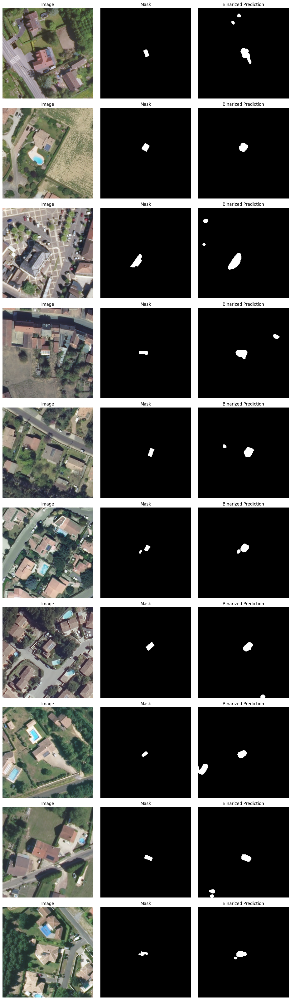

In [ ]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.4

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
checkpoint_path = '/content/drive/MyDrive/LabIAGI_1948533/ign_semantic_segmentation/checkpoints/saved_models/baseline_with_weight/baseline_with_weight_epoch_29.pt'
checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))

def print_checkpoint(checkpoint):
    print("Checkpoint Contents:")
    print("====================")
    print(f"Train Loss: {checkpoint['train_loss']}")
    print("====================")
    print(f"type loss: {checkpoint['type_other_loss']}")
    print("====================")
    print(f"Validation Loss: {checkpoint['other_loss']}")
    print("====================")
    print(f"Learning Rate: {checkpoint['lr']}")
    print("====================")
    print(f"F1 Score: {checkpoint['f1-score']}")
    print("====================")
    print(f"Accuracy: {checkpoint['accuracy']}")
    print("====================")
    print(f"IoU: {checkpoint['iou']}")
    print("====================")
    print(f"mIoU: {checkpoint['miou']}")
    print("====================")
    print(f"Epoch: {checkpoint['epoch']}")
    print("====================")

print_checkpoint(checkpoint)

Checkpoint Contents:
Train Loss: [0.5018210999874605, 0.30465422715577817, 0.27226856619947487, 0.26230597258028054, 0.2157473260950711, 0.256655207886878, 0.22610593400895596, 0.1989348368305299, 0.17801257936904827, 0.18417585232398576, 0.1870022662397888, 0.16833017435338762, 0.14802587865334418, 0.1435796453927954, 0.17330727379562127, 0.15091666646508706, 0.14209469123226073, 0.23273072210657927, 0.14670059617815745, 0.1414752831786043, 0.12593006844528848, 0.11191761038369602, 0.11558113552422987, 0.11512212871780826, 0.1023661050065938, 0.09985625956000553, 0.08521824257655276, 0.07165603463848431, 0.06718185189593998, 0.06300045200623572]
type loss: validation
Validation Loss: [0.6023126238336166, 0.4944729804992676, 0.3062140593926112, 0.37224849686026573, 0.2311212521356841, 0.28637680783867836, 0.2655483890945713, 0.31374992957959574, 1.04262101277709, 0.23284909625848135, 0.20627946577345332, 0.2167896901567777, 0.2270629059833785, 0.18854585755616426, 0.23544327526663741, 

#Dataaug proof

##no data aug

In [ ]:
baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = baseline_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

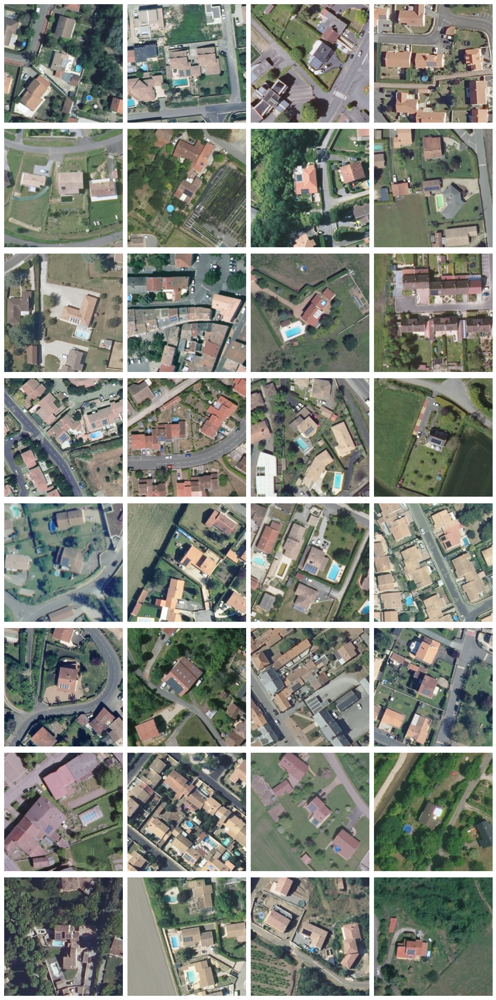

In [ ]:
import matplotlib.pyplot as plt

# Estrai il primo batch dal DataLoader
images, _ = next(iter(train_loader))

# Calcola il numero di righe e colonne per il layout
num_rows = 8
num_cols = 4

# Stampa le immagini
plt.figure(figsize=(12, 24))  # Imposta la dimensione della figura
for i in range(num_rows * num_cols):
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(images[i].permute(1, 2, 0))  # Permuta le dimensioni per adattarsi a imshow
    plt.axis('off')

plt.tight_layout()  # Regola automaticamente lo spaziamento tra i subplots
plt.show()


##data aug

In [ ]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Rotate(limit=270, p=1),  ##random rotate di 90 A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

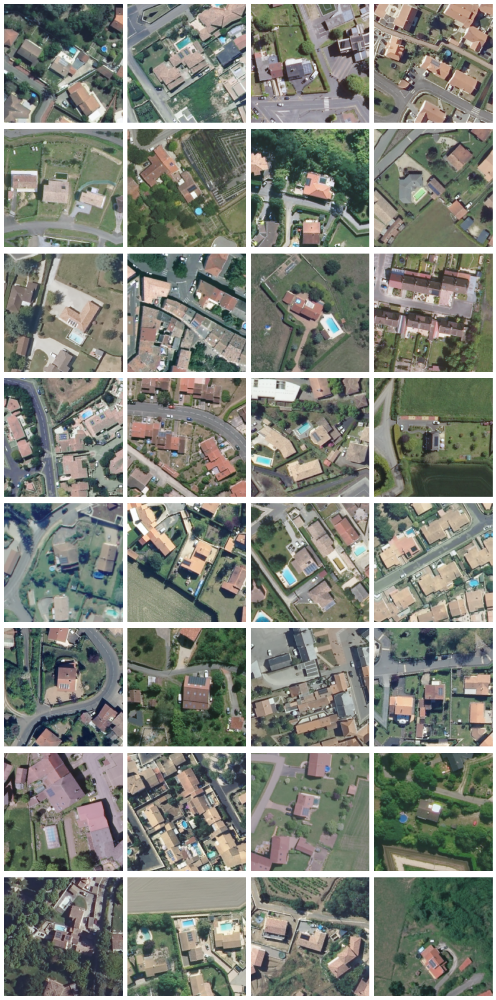

In [ ]:
import matplotlib.pyplot as plt

# Estrai il primo batch dal DataLoader
images, _ = next(iter(train_loader))

# Calcola il numero di righe e colonne per il layout
num_rows = 8
num_cols = 4

# Stampa le immagini
plt.figure(figsize=(12, 24))  # Imposta la dimensione della figura
for i in range(num_rows * num_cols):
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(images[i].permute(1, 2, 0))  # Permuta le dimensioni per adattarsi a imshow
    plt.axis('off')

plt.tight_layout()  # Regola automaticamente lo spaziamento tra i subplots
plt.show()

#PROVE

In [33]:
augmented_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=1),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

baseline_transform = A.Compose([
    A.Resize(height=h, width=w),
    A.Normalize(
        mean=[0.0, 0.0, 0.0],
        std=[1.0, 1.0, 1.0],
        max_pixel_value=255.0,
    ),
    ToTensorV2(),
])

train_set = IGNDataset(train_img, train_mask, transform = augmented_transform)
val_set = IGNDataset(val_img, val_mask, transform = baseline_transform)
test_set = IGNDataset(test_img, test_mask, transform = baseline_transform)

train_loader = DataLoader(train_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=True)
val_loader = DataLoader(val_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)
test_loader = DataLoader(test_set, batch_size, num_workers=num_workers, pin_memory=pin_memory, shuffle=False,)

In [34]:
model_name = 'augmented_with_weight'
model_trained_dir = os.path.join(model_dir, model_name)

# Imposta il nome specifico del checkpoint desiderato
specific_checkpoint_name = 'augmented_with_weight_epoch_24.pt'

# Percorso completo del checkpoint desiderato
specific_checkpoint_path = os.path.join(model_trained_dir, specific_checkpoint_name)

# Verifica se il checkpoint specifico esiste
if os.path.exists(specific_checkpoint_path):
    try:
        # Carica il checkpoint specifico
        checkpoint = torch.load(specific_checkpoint_path, map_location=torch.device('cpu'))
        train_loss = checkpoint['train_loss']
        val_loss = checkpoint['other_loss']
        f1_scores = checkpoint['f1-score']
        accuracy_scores = checkpoint['accuracy']
        iou_scores = checkpoint['iou']
        miou_scores = checkpoint['miou']
        start_epoch = checkpoint['epoch']
        model_state_dict = checkpoint['model_state_dict']
        optimizer_state_dict = checkpoint['optimizer_state_dict']

        # Stampa un messaggio informativo
        print(f"Caricato il checkpoint specifico: {specific_checkpoint_name}")

    except Exception as e:
        print(f"Errore durante il caricamento del checkpoint specifico: {e}")
else:
    print(f"Checkpoint specifico non trovato: {specific_checkpoint_path}")

model.eval()  # Set the model to evaluation mode
y_true = []
y_pred = []
test_loss = 0.0

# Load all batches with tqdm
data_iterator = tqdm(test_loader, desc='test', position=0, leave=True)

with torch.no_grad():
  for batch_idx, (images, masks) in enumerate(data_iterator):
    masks = masks.float().unsqueeze(1).to(DEVICE)
    images = images.to(DEVICE)
    outputs = model(images)
    '''
    loss = criterion(outputs, masks)
    test_loss += loss.item()
    '''
    preds = torch.sigmoid(outputs)
    preds[preds >= 0.5] = 1
    preds[preds < 0.5] = 0
    masks_np = masks.cpu().numpy().squeeze().flatten()
    preds_np = preds.cpu().numpy().squeeze().flatten()
    y_true.extend(masks_np)
    y_pred.extend(preds_np)
    data_iterator.set_postfix({'loss': test_loss / (batch_idx + 1)})

f1_score, iou, miou, accuracy = metrics(y_true, y_pred)

Caricato il checkpoint specifico: augmented_with_weight_epoch_24.pt


test: 100%|██████████| 49/49 [00:19<00:00,  2.58it/s, loss=0]
<ipython-input-13-d5492d2bc817>:6: RuntimeWarning: invalid value encountered in scalar divide
  precision = tp / (tp + fp)


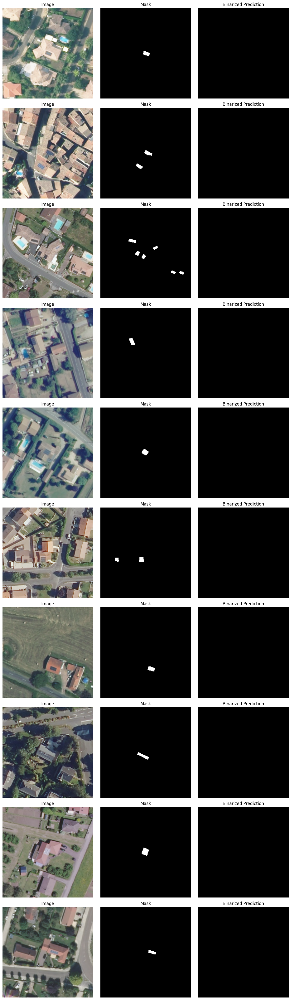

In [35]:
images_np = images.cpu().detach().numpy()
masks_np = masks.cpu().detach().numpy()
preds_np = preds.cpu().detach().numpy()

import matplotlib.pyplot as plt

# Assuming you have the tensors for images, masks, and predictions
# Convert tensors to NumPy arrays
images_np = images.cpu().numpy()
masks_np = masks.cpu().numpy()
preds_np = preds.cpu().detach().numpy()

# Define a threshold for binarization
threshold = 0.5

# Binarize the predictions
preds_binary_np = (preds_np > threshold).astype(int)

# Plot the images, masks, and binarized predictions
num_samples = min(images.size(0), 10)  # Limit to show at most 4 samples
fig, axes = plt.subplots(num_samples, 3, figsize=(12, num_samples * 4))
for i in range(num_samples):
    axes[i, 0].imshow(images_np[i].transpose(1, 2, 0))
    axes[i, 0].set_title('Image')
    axes[i, 0].axis('off')

    axes[i, 1].imshow(masks_np[i].squeeze(), cmap='gray')
    axes[i, 1].set_title('Mask')
    axes[i, 1].axis('off')

    axes[i, 2].imshow(preds_binary_np[i].squeeze(), cmap='gray')
    axes[i, 2].set_title('Binarized Prediction')
    axes[i, 2].axis('off')

plt.tight_layout()
plt.show()